<a href="https://colab.research.google.com/github/michp15/DSC514_NLP_Project/blob/main/clustering_food.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [50]:
import numpy as np
import pandas as pd
import re
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.manifold import TSNE
from wordcloud import WordCloud
from tqdm.notebook import tqdm
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import silhouette_score


# Loading & Exploring

In [ ]:
# Install dependencies as needed:
# pip install kagglehub[pandas-datasets]
import kagglehub
from kagglehub import KaggleDatasetAdapter

# Set the path to the file you'd like to load
file_path = "RecipeNLG_dataset.csv"

# Load the latest version
df = kagglehub.load_dataset(
  KaggleDatasetAdapter.PANDAS,
  "paultimothymooney/recipenlg",
  file_path,
  # Provide any additional arguments like
  # sql_query or pandas_kwargs. See the
  # documenation for more information:
  # https://github.com/Kaggle/kagglehub/blob/main/README.md#kaggledatasetadapterpandas
)

<ipython-input-2-4af3177ee35f>:10: DeprecationWarning: load_dataset is deprecated and will be removed in future version.
  df = kagglehub.load_dataset(


100%|██████████| 638M/638M [00:14<00:00, 47.0MB/s]

Extracting zip of RecipeNLG_dataset.csv...


In [ ]:
#df = pd.read_csv("/kaggle/input/recipenlg/RecipeNLG_dataset.csv")
df.head()

,Unnamed: 0,title,ingredients,directions,link,source,NER
0,0,No-Bake Nut Cookies,"[""1 c. firmly packed brown sugar"", ""1/2 c. eva...","[""In a heavy 2-quart saucepan, mix brown sugar...",www.cookbooks.com/Recipe-Details.aspx?id=44874,Gathered,"[""brown sugar"", ""milk"", ""vanilla"", ""nuts"", ""bu..."
1,1,Jewell Ball'S Chicken,"[""1 small jar chipped beef, cut up"", ""4 boned ...","[""Place chipped beef on bottom of baking dish....",www.cookbooks.com/Recipe-Details.aspx?id=699419,Gathered,"[""beef"", ""chicken breasts"", ""cream of mushroom..."
2,2,Creamy Corn,"[""2 (16 oz.) pkg. frozen corn"", ""1 (8 oz.) pkg...","[""In a slow cooker, combine all ingredients. C...",www.cookbooks.com/Recipe-Details.aspx?id=10570,Gathered,"[""frozen corn"", ""cream cheese"", ""butter"", ""gar..."
3,3,Chicken Funny,"[""1 large whole chicken"", ""2 (10 1/2 oz.) cans...","[""Boil and debone chicken."", ""Put bite size pi...",www.cookbooks.com/Recipe-Details.aspx?id=897570,Gathered,"[""chicken"", ""chicken gravy"", ""cream of mushroo..."
4,4,Reeses Cups(Candy),"[""1 c. peanut butter"", ""3/4 c. graham cracker ...","[""Combine first four ingredients and press in ...",www.cookbooks.com/Recipe-Details.aspx?id=659239,Gathered,"[""peanut butter"", ""graham cracker crumbs"", ""bu..."


In [ ]:
print("The shape of the data:")
df.shape

The shape of the data:


(2231142, 7)

In [ ]:
print("The columns names:")
df.columns

The columns names:


Index(['Unnamed: 0', 'title', 'ingredients', 'directions', 'link', 'source',
       'NER'],
      dtype='object')

# Pre-processing

In [ ]:
df['source'].unique()

array(['Gathered', 'Recipes1M'], dtype=object)

In [ ]:
df = df.drop(['Unnamed: 0', 'link', 'source'], axis=1)

In [ ]:
df.duplicated().sum()

np.int64(0)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2231142 entries, 0 to 2231141
Data columns (total 4 columns):
 #   Column       Dtype 
---  ------       ----- 
 0   title        object
 1   ingredients  object
 2   directions   object
 3   NER          object
dtypes: object(4)
memory usage: 68.1+ MB


## Preprocess text in the columns

In [ ]:
df.head()

,title,ingredients,directions,NER
0,No-Bake Nut Cookies,"[""1 c. firmly packed brown sugar"", ""1/2 c. eva...","[""In a heavy 2-quart saucepan, mix brown sugar...","[""brown sugar"", ""milk"", ""vanilla"", ""nuts"", ""bu..."
1,Jewell Ball'S Chicken,"[""1 small jar chipped beef, cut up"", ""4 boned ...","[""Place chipped beef on bottom of baking dish....","[""beef"", ""chicken breasts"", ""cream of mushroom..."
2,Creamy Corn,"[""2 (16 oz.) pkg. frozen corn"", ""1 (8 oz.) pkg...","[""In a slow cooker, combine all ingredients. C...","[""frozen corn"", ""cream cheese"", ""butter"", ""gar..."
3,Chicken Funny,"[""1 large whole chicken"", ""2 (10 1/2 oz.) cans...","[""Boil and debone chicken."", ""Put bite size pi...","[""chicken"", ""chicken gravy"", ""cream of mushroo..."
4,Reeses Cups(Candy),"[""1 c. peanut butter"", ""3/4 c. graham cracker ...","[""Combine first four ingredients and press in ...","[""peanut butter"", ""graham cracker crumbs"", ""bu..."


In [ ]:
df_clean = df.copy()

### Title column

In [ ]:
df['title']

,title
0,No-Bake Nut Cookies
1,Jewell Ball'S Chicken
2,Creamy Corn
3,Chicken Funny
4,Reeses Cups(Candy)
...,...
2231137,Sunny's Fake Crepes
2231138,Devil Eggs
2231139,Extremely Easy and Quick - Namul Daikon Salad
2231140,Pan-Roasted Pork Chops With Apple Fritters


In [ ]:
def clean_title(text):
    if isinstance(text, float):  # check for NaN
        return ""
    text = text.lower()
    text = re.sub(r"[^a-zA-Z\s]", "", text)  # remove punctuation/numbers
    text = re.sub(r"\s+", " ", text).strip()  # remove extra spaces
    return text

In [ ]:
df_clean['title'] = df['title'].apply(clean_title)

In [ ]:
df_clean['title']

,title
0,nobake nut cookies
1,jewell balls chicken
2,creamy corn
3,chicken funny
4,reeses cupscandy
...,...
2231137,sunnys fake crepes
2231138,devil eggs
2231139,extremely easy and quick namul daikon salad
2231140,panroasted pork chops with apple fritters


### Ingredients Column

In [ ]:
df['ingredients']

,ingredients
0,"[""1 c. firmly packed brown sugar"", ""1/2 c. eva..."
1,"[""1 small jar chipped beef, cut up"", ""4 boned ..."
2,"[""2 (16 oz.) pkg. frozen corn"", ""1 (8 oz.) pkg..."
3,"[""1 large whole chicken"", ""2 (10 1/2 oz.) cans..."
4,"[""1 c. peanut butter"", ""3/4 c. graham cracker ..."
...,...
2231137,"[""1/2 cup chocolate hazelnut spread (recommend..."
2231138,"[""1 dozen eggs"", ""1 paprika"", ""1 salt and pepp..."
2231139,"[""150 grams Daikon radish"", ""1 tbsp Sesame oil..."
2231140,"[""1 cup apple cider"", ""6 tablespoons sugar"", ""..."


In [ ]:
import ast

def clean_ingredient_text(text):
    if isinstance(text, float):
        return ""
    text = text.lower()
    text = re.sub(r"[^\w\s./]", "", text)  # keep words, spaces, dots, and slashes
    text = re.sub(r"\s+", " ", text).strip()
    return text

def process_ingredients(ingredients):
    if isinstance(ingredients, float):
        return ""
    ingredients = ast.literal_eval(ingredients)
    ingredients = [clean_ingredient_text(i) for i in ingredients]
    return ", ".join(ingredients)

In [ ]:
df_clean['ingredients'] = df['ingredients'].apply(process_ingredients)

In [ ]:
df_clean['ingredients']

,ingredients
0,"1 c. firmly packed brown sugar, 1/2 c. evapora..."
1,"1 small jar chipped beef cut up, 4 boned chick..."
2,"2 16 oz. pkg. frozen corn, 1 8 oz. pkg. cream ..."
3,"1 large whole chicken, 2 10 1/2 oz. cans chick..."
4,"1 c. peanut butter, 3/4 c. graham cracker crum..."
...,...
2231137,1/2 cup chocolate hazelnut spread recommended ...
2231138,"1 dozen eggs, 1 paprika, 1 salt and pepper to ..."
2231139,"150 grams daikon radish, 1 tbsp sesame oil, 1 ..."
2231140,"1 cup apple cider, 6 tablespoons sugar, 4 tabl..."


### Directions Column

In [ ]:
df['directions']

,directions
0,"[""In a heavy 2-quart saucepan, mix brown sugar..."
1,"[""Place chipped beef on bottom of baking dish...."
2,"[""In a slow cooker, combine all ingredients. C..."
3,"[""Boil and debone chicken."", ""Put bite size pi..."
4,"[""Combine first four ingredients and press in ..."
...,...
2231137,"[""Spread hazelnut spread on 1 side of each tor..."
2231138,"[""Boil eggs on medium for 30mins."", ""Then cool..."
2231139,"[""Julienne the daikon and squeeze out the exce..."
2231140,"[""In a large bowl, mix the apple cider with 4 ..."


In [ ]:
def clean_direction_text(text):
    if isinstance(text, float):
        return ""
    text = text.lower()
    text = re.sub(r"[^a-zA-Z0-9\s.,:;!?'-]", "", text)  # keep useful punctuation
    text = re.sub(r"\s+", " ", text).strip()
    return text

def process_directions(directions):
    if isinstance(directions, float):
        return ""
    directions = ast.literal_eval(directions)  # convert string to list
    directions = [clean_direction_text(i) for i in directions]
    return " ".join(directions)  # join with space between steps

In [ ]:
df_clean['directions'] = df['directions'].apply(process_directions)

In [ ]:
df_clean['directions']

,directions
0,"in a heavy 2-quart saucepan, mix brown sugar, ..."
1,place chipped beef on bottom of baking dish. p...
2,"in a slow cooker, combine all ingredients. cov..."
3,boil and debone chicken. put bite size pieces ...
4,combine first four ingredients and press in 13...
...,...
2231137,spread hazelnut spread on 1 side of each torti...
2231138,boil eggs on medium for 30mins. then cool eggs...
2231139,julienne the daikon and squeeze out the excess...
2231140,"in a large bowl, mix the apple cider with 4 cu..."


### NER Column

In [ ]:
df['NER']

,NER
0,"[""brown sugar"", ""milk"", ""vanilla"", ""nuts"", ""bu..."
1,"[""beef"", ""chicken breasts"", ""cream of mushroom..."
2,"[""frozen corn"", ""cream cheese"", ""butter"", ""gar..."
3,"[""chicken"", ""chicken gravy"", ""cream of mushroo..."
4,"[""peanut butter"", ""graham cracker crumbs"", ""bu..."
...,...
2231137,"[""chocolate hazelnut spread"", ""tortillas"", ""bu..."
2231138,"[""eggs"", ""paprika"", ""salt"", ""choice"", ""miracle..."
2231139,"[""radish"", ""Sesame oil"", ""White sesame seeds"",..."
2231140,"[""apple cider"", ""sugar"", ""kosher salt"", ""bay l..."


In [ ]:
df_clean['NER'] = [d.lower() for d in df["NER"]]

In [ ]:
df_clean['NER']

,NER
0,"[""brown sugar"", ""milk"", ""vanilla"", ""nuts"", ""bu..."
1,"[""beef"", ""chicken breasts"", ""cream of mushroom..."
2,"[""frozen corn"", ""cream cheese"", ""butter"", ""gar..."
3,"[""chicken"", ""chicken gravy"", ""cream of mushroo..."
4,"[""peanut butter"", ""graham cracker crumbs"", ""bu..."
...,...
2231137,"[""chocolate hazelnut spread"", ""tortillas"", ""bu..."
2231138,"[""eggs"", ""paprika"", ""salt"", ""choice"", ""miracle..."
2231139,"[""radish"", ""sesame oil"", ""white sesame seeds"",..."
2231140,"[""apple cider"", ""sugar"", ""kosher salt"", ""bay l..."


### Clean Columns

In [ ]:
title_punctuations = ingredients_punctuations = list(
    filter(
        lambda t: all(c in string.punctuation for c in t),
        df_clean["title"]
    )
)

ingredients_punctuations = list(
    filter(
        lambda t: all(c in string.punctuation for c in t),
        df_clean["ingredients"]
    )
)

directions_punctuations = list(
    filter(
        lambda t: all(c in string.punctuation for c in t),
        df_clean["directions"]
    )
)

ner_punctuations = list(
    filter(
        lambda t: all(c in string.punctuation for c in t),
        df_clean["NER"]
    )
)

In [ ]:
print('Titles Punctuations:\n', title_punctuations)
print('Ingredients Punctuations:\n', ingredients_punctuations)
print('Direction Punctuations:\n', directions_punctuations)
print('NER Punctuations:\n', ner_punctuations)

Titles Punctuations:
 ['', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '', '']
Ingredients Punctuations:
 ['.', '.', '.', '.', '..................................................................']
Direction Punctuations:
 ['..................................................................', '.', '.', ':', '.']
NER Punctuations:
 ['[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]', '[]',

In [ ]:
from tqdm.notebook import tqdm

title_clean = [t for t in tqdm(df_clean["title"]) if t not in title_punctuations]
ingredients_clean = [t for t in tqdm(df_clean["ingredients"]) if t not in ingredients_punctuations]
directions_clean = [t for t in tqdm(df_clean["directions"]) if t not in directions_punctuations]
ner_clean = [t for t in tqdm(df_clean["NER"]) if t not in ner_punctuations]

  0%|          | 0/2231142 [00:00<?, ?it/s]

  0%|          | 0/2231142 [00:00<?, ?it/s]

  0%|          | 0/2231142 [00:00<?, ?it/s]

  0%|          | 0/2231142 [00:00<?, ?it/s]

In [ ]:
# Get the indices of clean ingredients, directions, ner based on original df_clean
ingredients_indices = [i for i, t in enumerate(df_clean["ingredients"]) if t not in ingredients_punctuations]
directions_indices = [i for i, t in enumerate(df_clean["directions"]) if t not in directions_punctuations]
ner_indices = [i for i, t in enumerate(df_clean["NER"]) if t not in ner_punctuations]

# Clustering

## Based on title

### TF-IDF

In [ ]:
tfidf_vectorizer = TfidfVectorizer(max_features=1000, stop_words='english')
title_vectors = tfidf_vectorizer.fit_transform(title_clean)
print("TF-IDF shape:", title_vectors.shape)

TF-IDF shape: (2231099, 1000)


#### K-means

In [ ]:
kmeans = KMeans(n_clusters=10, random_state=42, n_init=10)
title_cluster_tfidf_kmeans = kmeans.fit_predict(title_vectors)

<ipython-input-33-9d52e2684e29>:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=title_cluster_tfidf_kmeans, palette='tab10')


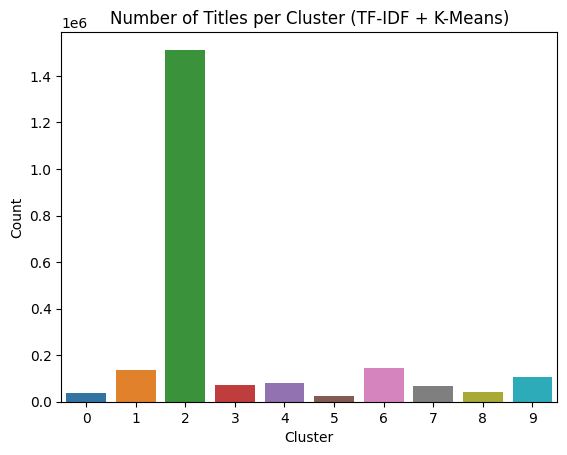

In [ ]:
sns.countplot(x=title_cluster_tfidf_kmeans, palette='tab10')
plt.title('Number of Titles per Cluster (TF-IDF + K-Means)')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.show()

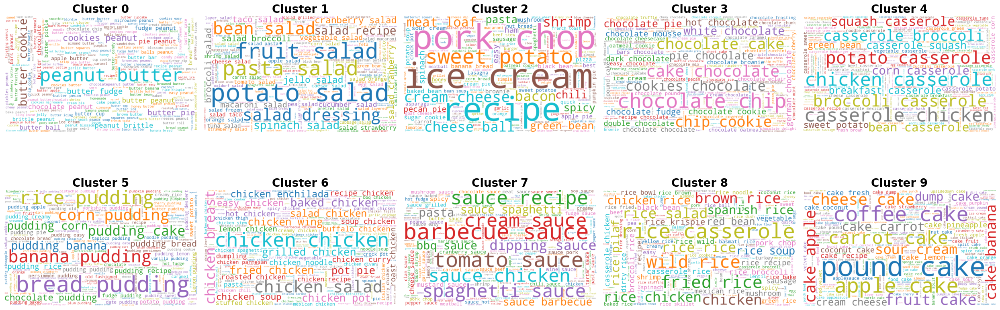

In [ ]:
# Create figure
fig, axes = plt.subplots(2, 5, figsize=(25, 10))  # 2 rows, 5 cols
axes = axes.flatten()  # Flatten to loop easily

for idx, cluster in enumerate(sorted(set(title_cluster_tfidf_kmeans))):
    # Get indexes of samples in this cluster
    indices = [i for i, label in enumerate(title_cluster_tfidf_kmeans) if label == cluster]

    # Collect titles from those indexes
    cluster_titles = [title_clean[i] for i in indices]

    # Join into text
    text = " ".join(cluster_titles)

    # Generate WordCloud
    wordcloud = WordCloud(width=1000, height=600, background_color='white', colormap='tab10').generate(text)

    # Plot in grid
    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(f'Cluster {cluster}', fontsize=20, fontweight='bold')
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
# Took a lot of time
"""try:
    print("=== TF-IDF Clustering Evaluation ===")
    tfidf_kmeans_score = silhouette_score(title_vectors, title_cluster_tfidf_kmeans)
    print(f"TF-IDF + KMeans Silhouette Score: {tfidf_kmeans_score:.4f}")
except Exception as e:
    print("TF-IDF + KMeans evaluation failed:", e)"""

"""try:
    tfidf_agglo_score = silhouette_score(title_vectors.toarray(), title_cluster_tfidf_agglo)
    print(f"TF-IDF + Agglomerative Silhouette Score: {tfidf_agglo_score:.4f}")
except Exception as e:
    print("TF-IDF + Agglomerative evaluation failed:", e)"""

### BERT

In [37]:
import random
from sentence_transformers import SentenceTransformer

model = SentenceTransformer('all-MiniLM-L6-v2')

# Set seed for reproducibility
random.seed(42)

# Get 10,000 random indices
sample_idx = random.sample(range(len(title_clean)), 25000)

# Create your sampled titles
title_clean_sample = [title_clean[i] for i in sample_idx]

title_embeddings = model.encode(title_clean_sample, show_progress_bar=True)
print("Embeddings shape:", title_embeddings.shape)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.5k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Batches:   0%|          | 0/782 [00:00<?, ?it/s]

Embeddings shape: (25000, 384)


#### Agglomerative Hierarchical Clustering

In [36]:
# Select 5000 random indices
sample_idx = random.sample(range(len(title_embeddings)), 5000)

# Sample the embeddings and the corresponding titles
title_embeddings_sample = np.array([title_embeddings[i] for i in sample_idx])
title_clean_sample_5k = [title_clean[i] for i in sample_idx]

agglo = AgglomerativeClustering(n_clusters=10, metric='euclidean', linkage='ward')
title_cluster_bert_agglo = agglo.fit_predict(title_embeddings_sample)

NameError: name 'random' is not defined

In [ ]:
sns.countplot(x=title_cluster_bert_agglo, palette='tab10')
plt.title('Number of Titles per Cluster (BERT + Hierarchical Clustering)')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.show()

In [ ]:
fig, axes = plt.subplots(2, 5, figsize=(25, 10))
axes = axes.flatten()

for idx, cluster in enumerate(sorted(set(title_cluster_bert_agglo))):
    indices = [i for i, label in enumerate(title_cluster_bert_agglo) if label == cluster]
    cluster_titles = [title_clean_sample_5k[i] for i in indices]
    text = " ".join(cluster_titles)

    wordcloud = WordCloud(width=1000, height=600, background_color='white', colormap='tab10').generate(text)

    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(f'Cluster {cluster}', fontsize=20, fontweight='bold')
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

#### K-means

In [ ]:
kmeans_bert = KMeans(n_clusters=10, random_state=42, n_init=10)
title_cluster_bert_kmeans = kmeans_bert.fit_predict(title_embeddings)

<ipython-input-40-b72f98263de8>:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=title_cluster_bert_kmeans, palette='tab10')


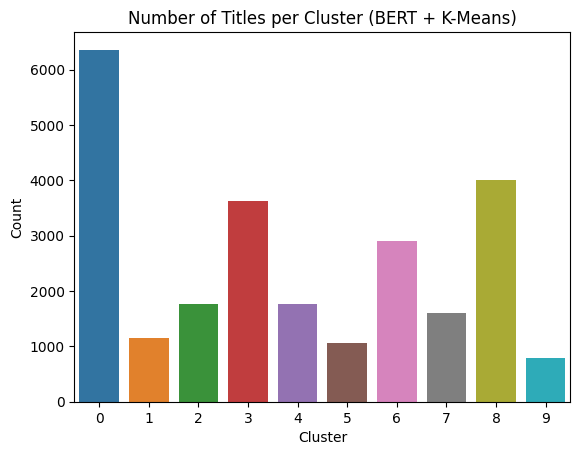

In [ ]:
sns.countplot(x=title_cluster_bert_kmeans, palette='tab10')
plt.title('Number of Titles per Cluster (BERT + K-Means)')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.show()

In [ ]:
fig, axes = plt.subplots(2, 5, figsize=(25, 10))
axes = axes.flatten()

for idx, cluster in enumerate(sorted(set(title_cluster_bert_kmeans))):
    indices = [i for i, label in enumerate(title_cluster_bert_kmeans) if label == cluster]
    cluster_titles = [title_clean_sample[i] for i in indices]
    text = " ".join(cluster_titles)

    wordcloud = WordCloud(width=1000, height=600, background_color='white', colormap='tab10').generate(text)

    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(f'Cluster {cluster}', fontsize=20, fontweight='bold')
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

##### Evaluate

In [ ]:
print("\n=== BERT Clustering Evaluation (sample of 50k) ===")
try:
    bert_kmeans_score = silhouette_score(title_embeddings, title_cluster_bert_kmeans)
    print(f"BERT + KMeans Silhouette Score: {bert_kmeans_score:.4f}")
except Exception as e:
    print("BERT + KMeans evaluation failed:", e)

try:
    bert_agglo_score = silhouette_score(title_embeddings_sample, title_cluster_bert_agglo)
    print(f"BERT + Agglomerative Silhouette Score (sample of 5k): {bert_agglo_score:.4f}")
except Exception as e:
    print("BERT + Agglomerative evaluation failed:", e)

=== TF-IDF Clustering Evaluation ===

=== BERT Clustering Evaluation (sample of 50k) ===
BERT + KMeans Silhouette Score: 0.0299
BERT + Agglomerative Silhouette Score: -0.0058


##### Tuning with Elbow Method

In [ ]:
inertias = []
for i in range(5,160, 5):
    kmeans = KMeans(n_clusters=i, random_state=42, n_init=10)
    kmeans.fit(title_embeddings)
    inertias.append(kmeans.inertia_)

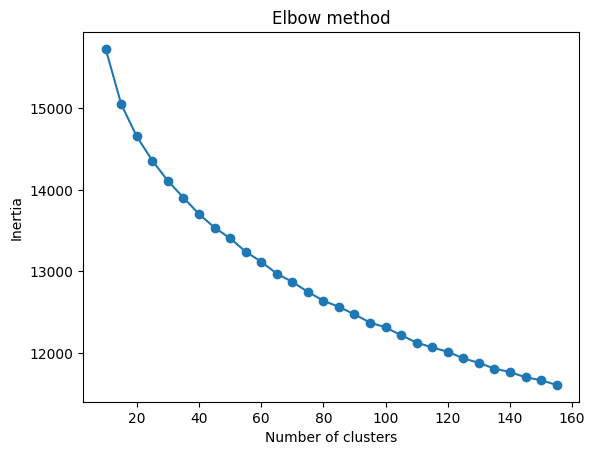

In [43]:
plt.plot(range(10,160, 5), inertias, marker='o')
plt.title('Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

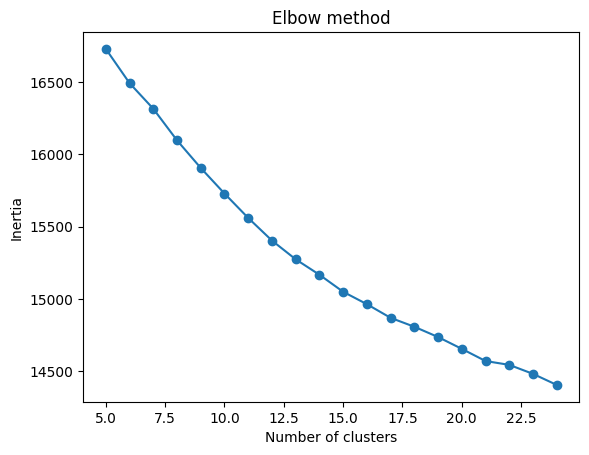

In [45]:
inertias = []
for i in range(5,25, 1):
    kmeans = KMeans(n_clusters=i, random_state=42, n_init=10)
    kmeans.fit(title_embeddings)
    inertias.append(kmeans.inertia_)

plt.plot(range(5,25, 1), inertias, marker='o')
plt.title('Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

From the plots, I think 20 clusters will be a good number

<ipython-input-91-3bac136690c8>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=title_cluster_bert_kmeans, palette='tab10')


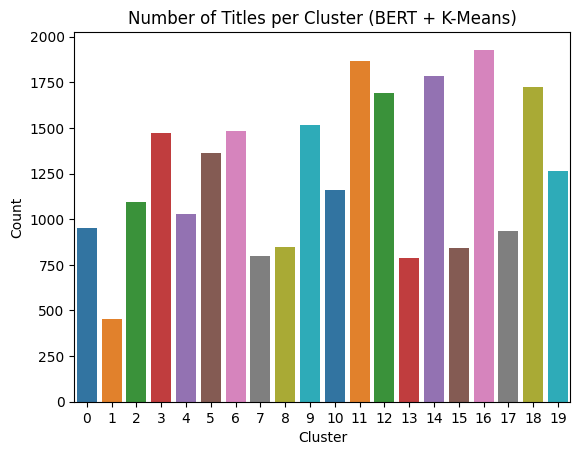

In [91]:
kmeans_bert = KMeans(n_clusters=20, random_state=42, n_init=10)
title_cluster_bert_kmeans = kmeans_bert.fit_predict(title_embeddings)

sns.countplot(x=title_cluster_bert_kmeans, palette='tab10')
plt.title('Number of Titles per Cluster (BERT + K-Means)')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.show()

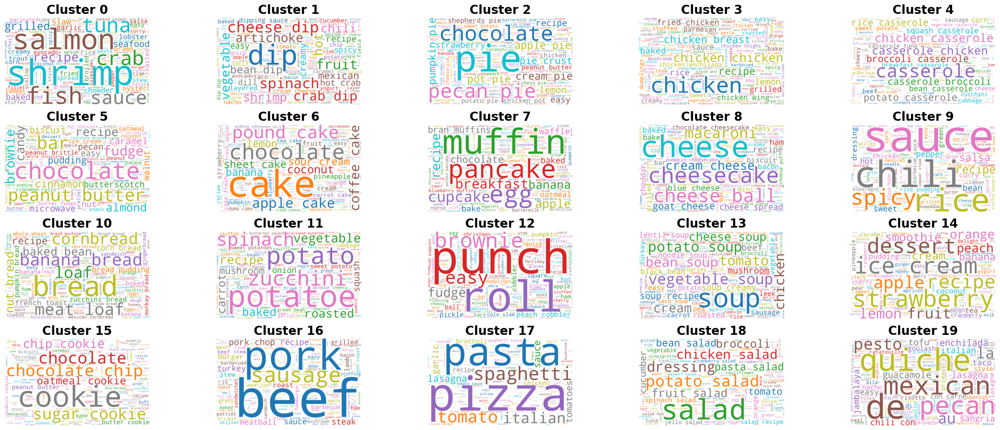

In [92]:
fig, axes = plt.subplots(4, 5, figsize=(25, 10))
axes = axes.flatten()

for idx, cluster in enumerate(sorted(set(title_cluster_bert_kmeans))):
    indices = [i for i, label in enumerate(title_cluster_bert_kmeans) if label == cluster]
    cluster_titles = [title_clean_sample[i] for i in indices]
    text = " ".join(cluster_titles)

    wordcloud = WordCloud(width=1000, height=600, background_color='white', colormap='tab10').generate(text)

    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(f'Cluster {cluster}', fontsize=20, fontweight='bold')
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

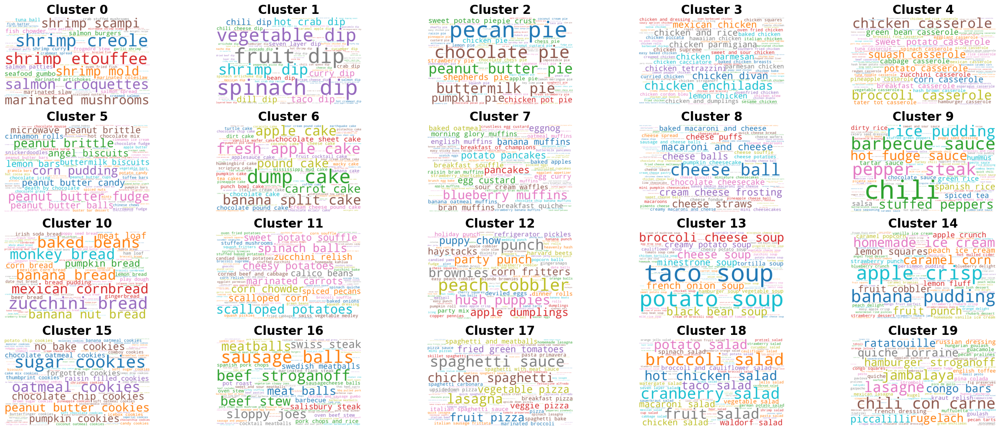

In [93]:
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt

fig, axes = plt.subplots(4, 5, figsize=(25, 10))
axes = axes.flatten()

for idx, cluster in enumerate(sorted(set(title_cluster_bert_kmeans))):
    # Get titles for this cluster
    indices = [i for i, label in enumerate(title_cluster_bert_kmeans) if label == cluster]
    cluster_titles = [title_clean_sample[i] for i in indices]

    # Count full titles (each title as a token)
    title_freq = Counter(cluster_titles)

    # Generate WordCloud from full titles
    wordcloud = WordCloud(
        width=1000,
        height=600,
        background_color='white',
        colormap='tab10',
        prefer_horizontal=1.0,
        max_words=100
    ).generate_from_frequencies(title_freq)

    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(f'Cluster {cluster}', fontsize=20, fontweight='bold')
    axes[idx].axis('off')

# Hide unused axes if any
for ax in axes[len(set(title_cluster_bert_kmeans)):]:
    ax.axis('off')

plt.tight_layout()
plt.show()

In [94]:
bert_kmeans_score = silhouette_score(title_embeddings, title_cluster_bert_kmeans)
print(f"BERT + KMeans Silhouette Score: {bert_kmeans_score:.4f}")

BERT + KMeans Silhouette Score: 0.0554


#### Categories Similarity Clustering

In [59]:
categories = [
    "appetizer",
    "salad",
    "soup",
    "pasta",
    "meat",
    "fish",
    "rice",
    "side dish",
    "dessert",
    "breakfast",
    "snack",
    "drink",
    "sauce"
]

#model = SentenceTransformer("all-MiniLM-L6-v2")

category_embeddings = model.encode(categories)

# Set seed for reproducibility
#random.seed(42)
#sample_idx = random.sample(range(len(title_clean)), 25000)
#title_clean_sample = [title_clean[i] for i in sample_idx]

#title_embeddings = model.encode(title_clean_sample, show_progress_bar=True)

In [60]:
from sklearn.metrics.pairwise import cosine_similarity

similarities = cosine_similarity(title_embeddings, category_embeddings)

# Assign category with highest similarity
predicted_category_indices = np.argmax(similarities, axis=1)
title_predicted_categories = [categories[i] for i in predicted_category_indices]

<ipython-input-61-7c3d6ad000e6>:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=title_predicted_categories, order=categories, palette="tab10")


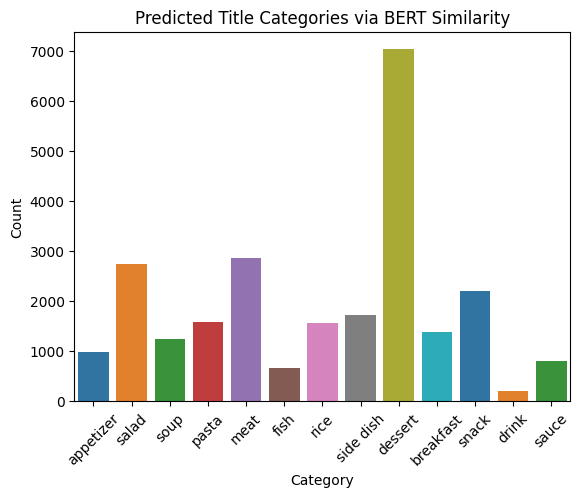

In [61]:
sns.countplot(x=title_predicted_categories, order=categories, palette="tab10")
plt.title("Predicted Title Categories via BERT Similarity")
plt.xlabel("Category")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

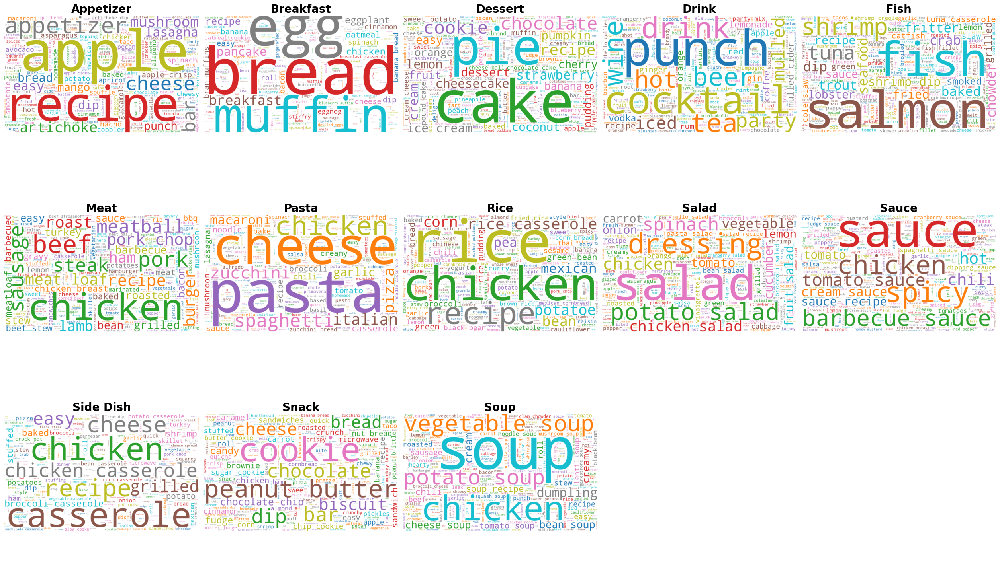

In [62]:
unique_categories = sorted(set(title_predicted_categories))
num_categories = len(unique_categories)

# Create grid
rows = (num_categories + 4) // 5  # 5 per row
fig, axes = plt.subplots(rows, 5, figsize=(25, 5 * rows), constrained_layout=True)
axes = axes.flatten()

for idx, category in enumerate(unique_categories):
    # Get titles for this category
    titles = [title_clean_sample[i] for i, label in enumerate(title_predicted_categories) if label == category]
    text = " ".join(titles)

    wordcloud = WordCloud(
        width=1000, height=600,
        background_color='white',
        colormap='tab10',
        max_words=300
    ).generate(text)

    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(f"{category.title()}", fontsize=20, fontweight='bold')
    axes[idx].axis('off')

# Hide unused subplots if any
for ax in axes[len(unique_categories):]:
    ax.axis('off')

plt.show()

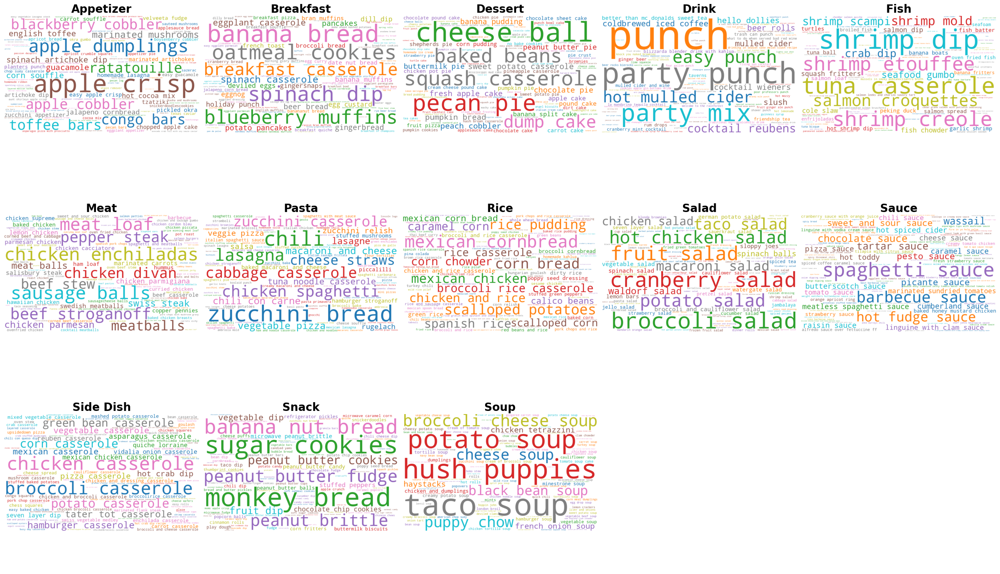

In [64]:
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt

rows = (num_categories + 4) // 5  # 5 per row
fig, axes = plt.subplots(rows, 5, figsize=(25, 5 * rows), constrained_layout=True)
axes = axes.flatten()

for idx, category in enumerate(sorted(set(title_predicted_categories))):
    # Get all full titles for this category
    titles = [title_clean_sample[i] for i, label in enumerate(title_predicted_categories) if label == category]

    # Create a Counter where each full title is one "word"
    title_freq = Counter(titles)

    # Generate WordCloud with full titles
    wordcloud = WordCloud(
        width=1000, height=600,
        background_color='white',
        colormap='tab10',
        prefer_horizontal=1.0,
        max_words=100
    ).generate_from_frequencies(title_freq)

    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(category.title(), fontsize=20, fontweight='bold')
    axes[idx].axis('off')

# Hide unused axes
for ax in axes[len(set(title_predicted_categories)):]:
    ax.axis('off')

plt.show()


##### Evaluate

In [65]:
from sklearn.metrics import silhouette_score

from sklearn.metrics import silhouette_score
from sklearn.preprocessing import LabelEncoder

# Encode string categories to integers
label_encoder = LabelEncoder()
category_labels_encoded = label_encoder.fit_transform(title_predicted_categories)


print("\n=== BERT Clustering Evaluation (sample of 50k) ===")
try:
    bert_categories_score = silhouette_score(title_embeddings, category_labels_encoded)
    print(f"BERT + Category Assignment Silhouette Score: {bert_categories_score:.4f}")
except Exception as e:
    print("BERT + KMeans evaluation failed:", e)


=== BERT Clustering Evaluation (sample of 50k) ===
BERT + Category Assignment Silhouette Score: 0.0260


## Based on NER

### BERT

In [73]:
import random
from sentence_transformers import SentenceTransformer

# Get 25,000 random indices
random.seed(42)
sample_idx = random.sample(range(len(ner_clean)), 25000)
ner_clean_sample = [ner_clean[i] for i in sample_idx]

# Convert strings to actual list and join into one string per row
ner_sample_texts = [
    " ".join(ast.literal_eval(item)) if isinstance(item, str) else ""
    for item in ner_clean_sample
]

# Also get the original df_clean indices for each NER entry
ner_sample_df_indices = [ner_indices[i] for i in sample_idx]

# Retrieve the titles corresponding to the sampled NER entries
ner_sample_titles = [df_clean.loc[i, "title"] for i in ner_sample_df_indices]

model = SentenceTransformer("all-MiniLM-L6-v2")
ner_embeddings = model.encode(ner_sample_texts, show_progress_bar=True)

Batches:   0%|          | 0/782 [00:00<?, ?it/s]

#### K-means

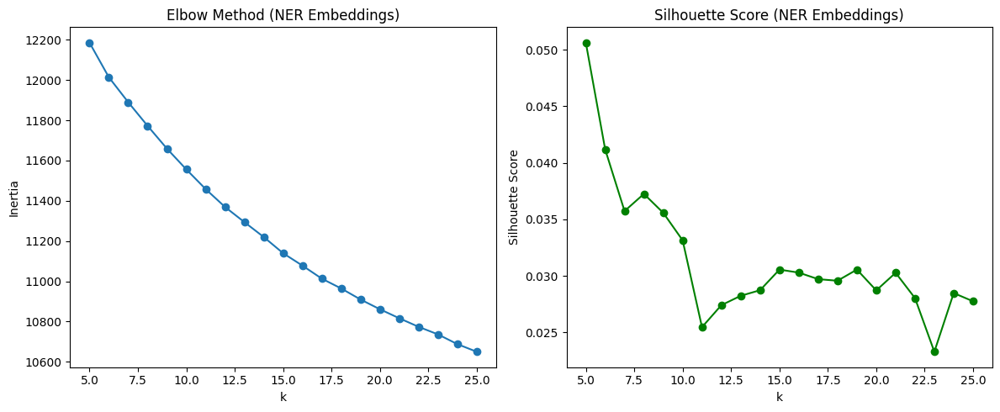

In [76]:
inertias = []
sil_scores = []
k_range = range(5, 26, 1)

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    labels = kmeans.fit_predict(ner_embeddings)
    inertias.append(kmeans.inertia_)
    sil_scores.append(silhouette_score(ner_embeddings, labels))

# Plot elbow + silhouette
plt.figure(figsize=(12, 5))

plt.plot(k_range, inertias, marker='o')
plt.title("Elbow Method (NER Embeddings)")
plt.xlabel("k")
plt.ylabel("Inertia")

plt.tight_layout()
plt.show()

Here I think 15 is a good balance

<ipython-input-78-e1b99cfc0eb0>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=ner_cluster_bert_kmeans, palette='tab10')


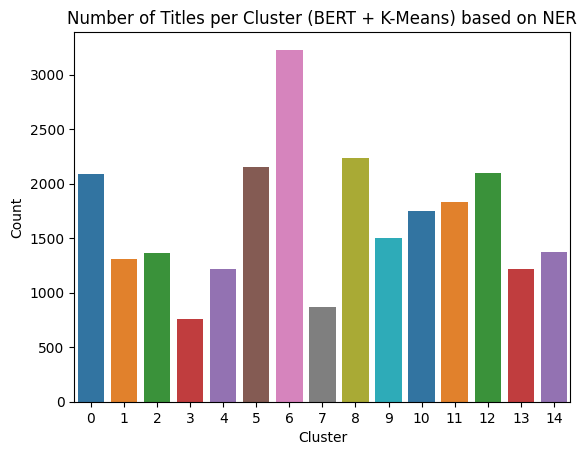

In [78]:
kmeans_bert_ner = KMeans(n_clusters=15, random_state=42, n_init=10)
ner_cluster_bert_kmeans = kmeans_bert_ner.fit_predict(ner_embeddings)

sns.countplot(x=ner_cluster_bert_kmeans, palette='tab10')
plt.title('Number of Titles per Cluster (BERT + K-Means) based on NER')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.show()

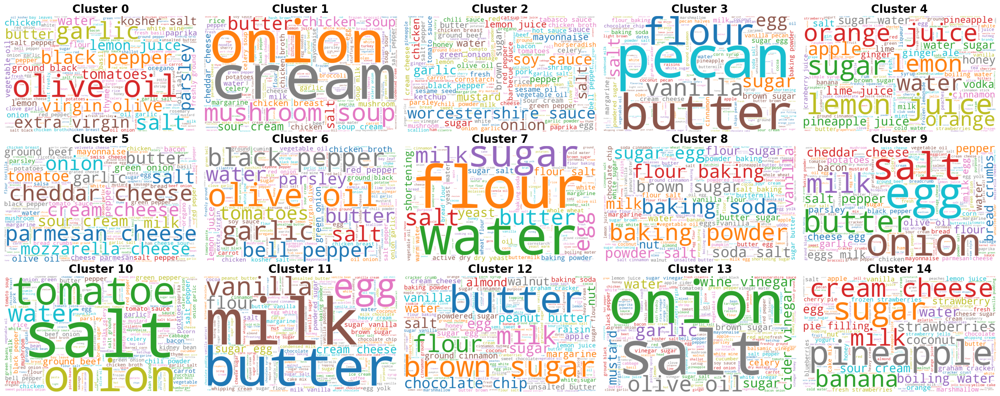

In [79]:
fig, axes = plt.subplots(3, 5, figsize=(25, 10))
axes = axes.flatten()

for idx, cluster in enumerate(sorted(set(ner_cluster_bert_kmeans))):
    indices = [i for i, label in enumerate(ner_cluster_bert_kmeans) if label == cluster]
    cluster_ner = [ner_clean_sample[i] for i in indices]
    text = " ".join(cluster_ner)

    wordcloud = WordCloud(width=1000, height=600, background_color='white', colormap='tab10').generate(text)

    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(f'Cluster {cluster}', fontsize=20, fontweight='bold')
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

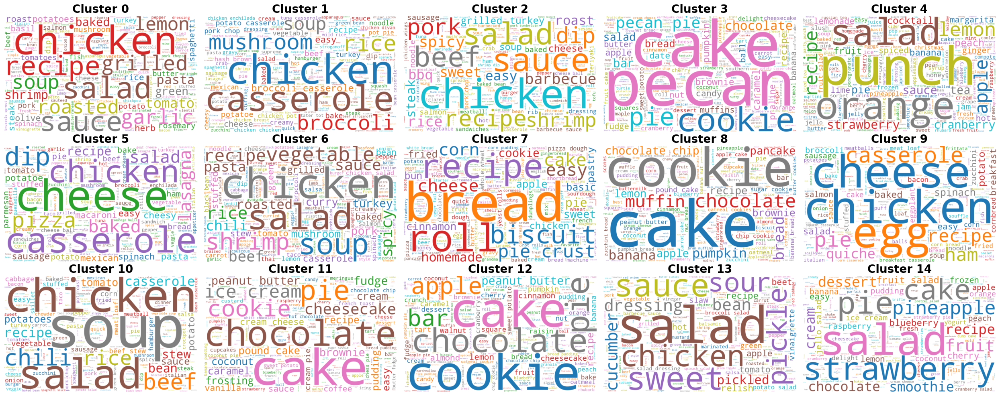

In [81]:
fig, axes = plt.subplots(3, 5, figsize=(25, 10))
axes = axes.flatten()

for idx, cluster in enumerate(sorted(set(ner_cluster_bert_kmeans))):
    indices = [i for i, label in enumerate(ner_cluster_bert_kmeans) if label == cluster]

    # Use the matching titles instead of NER
    cluster_titles = [ner_sample_titles[i] for i in indices]
    text = " ".join(cluster_titles)

    wordcloud = WordCloud(
        width=1000,
        height=600,
        background_color='white',
        colormap='tab10',
        max_words=300  # optional to keep it clean
    ).generate(text)

    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(f'Cluster {cluster}', fontsize=20, fontweight='bold')
    axes[idx].axis('off')

# Hide unused axes if k < 15
for ax in axes[len(set(ner_cluster_bert_kmeans)):]:
    ax.axis('off')

plt.tight_layout()
plt.show()

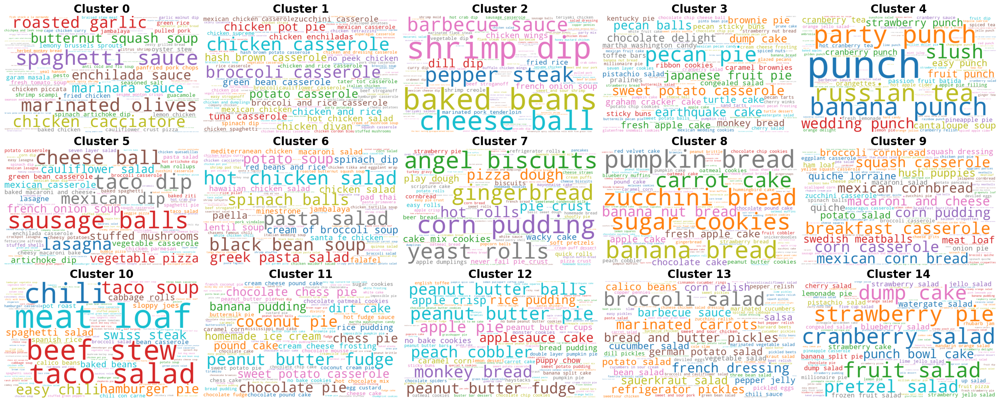

In [95]:
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt

fig, axes = plt.subplots(3, 5, figsize=(25, 10), constrained_layout=True)
axes = axes.flatten()

for idx, cluster in enumerate(sorted(set(ner_cluster_bert_kmeans))):
    indices = [i for i, label in enumerate(ner_cluster_bert_kmeans) if label == cluster]

    # Use the full titles as individual tokens
    cluster_titles = [ner_sample_titles[i] for i in indices]
    title_freq = Counter(cluster_titles)

    wordcloud = WordCloud(
        width=1000,
        height=600,
        background_color='white',
        colormap='tab10',
        prefer_horizontal=1.0,
        max_words=100
    ).generate_from_frequencies(title_freq)

    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(f'Cluster {cluster}', fontsize=20, fontweight='bold')
    axes[idx].axis('off')

# Hide unused axes if any
for ax in axes[len(set(ner_cluster_bert_kmeans)):]:
    ax.axis('off')

plt.show()

##### Evaluate

In [80]:
score = silhouette_score(ner_embeddings, ner_cluster_bert_kmeans)
print(f"KMeans Silhouette Score (NER Embeddings): {score:.4f}")

KMeans Silhouette Score (NER Embeddings): 0.0306


#### Categories Similarity Clustering

In [82]:
# (skip this if already done)
# model = SentenceTransformer('all-MiniLM-L6-v2')

#category_embeddings = model.encode(categories)
#ner_embeddings = model.encode(ner_sample_texts, show_progress_bar=True)


# Compute similarity between each NER entry and all category vectors
similarities = cosine_similarity(ner_embeddings, category_embeddings)

# Assign the closest category
predicted_category_indices = np.argmax(similarities, axis=1)
ner_predicted_categories = [categories[i] for i in predicted_category_indices]

<ipython-input-87-c919475d0976>:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=ner_predicted_categories, order=categories, palette="tab10")


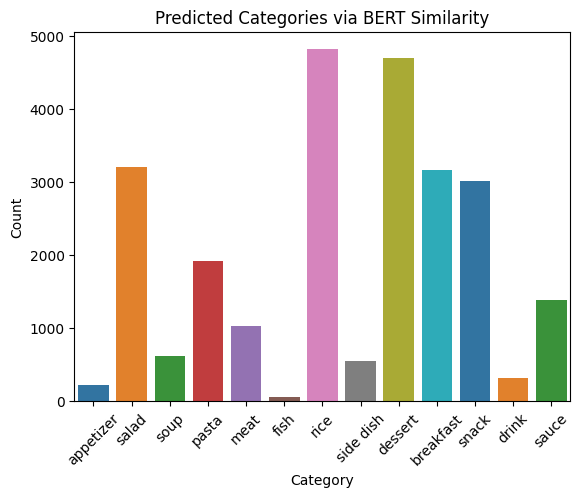

In [87]:
sns.countplot(x=ner_predicted_categories, order=categories, palette="tab10")
plt.title("Predicted Categories via BERT Similarity")
plt.xlabel("Category")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

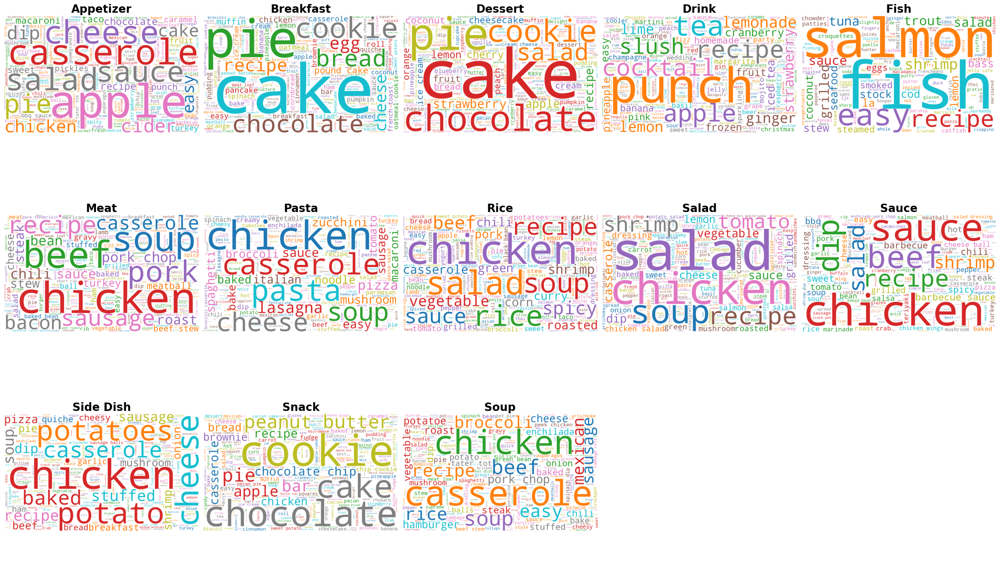

In [83]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

unique_categories = sorted(set(ner_predicted_categories))
n = len(unique_categories)
rows = (n + 4) // 5

fig, axes = plt.subplots(rows, 5, figsize=(25, 5 * rows), constrained_layout=True)
axes = axes.flatten()

for idx, cat in enumerate(unique_categories):
    indices = [i for i, label in enumerate(ner_predicted_categories) if label == cat]
    cluster_titles = [ner_sample_titles[i] for i in indices]
    text = " ".join(cluster_titles)

    wordcloud = WordCloud(
        width=1000, height=600,
        background_color='white', colormap='tab10',
        max_words=300
    ).generate(text)

    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(cat.title(), fontsize=20, fontweight='bold')
    axes[idx].axis('off')

# Hide unused axes
for ax in axes[n:]:
    ax.axis('off')

plt.show()

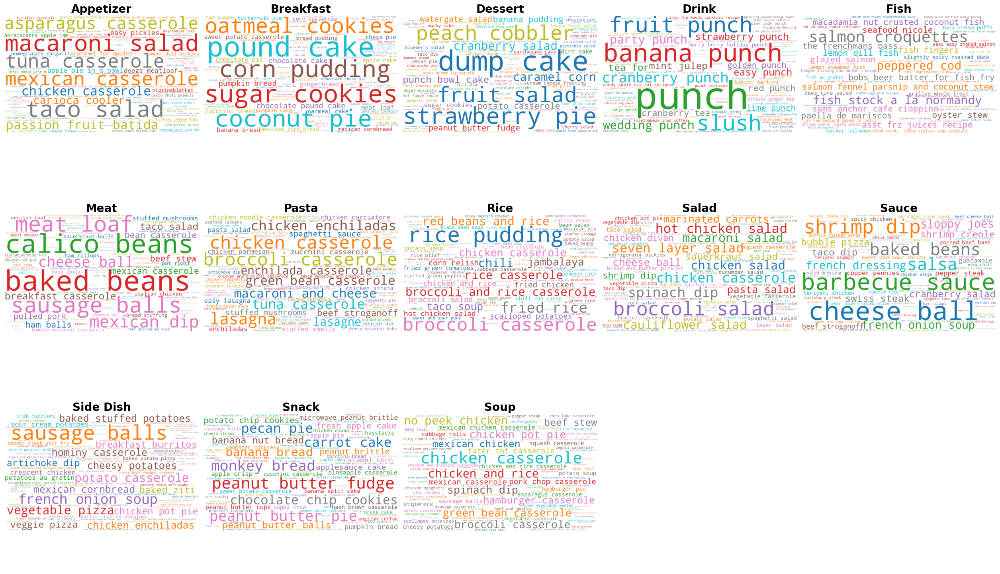

In [89]:
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt

unique_categories = sorted(set(ner_predicted_categories))
n = len(unique_categories)
rows = (n + 4) // 5  # 5 per row

fig, axes = plt.subplots(rows, 5, figsize=(25, 5 * rows), constrained_layout=True)
axes = axes.flatten()

for idx, cat in enumerate(unique_categories):
    # Get titles in this category
    indices = [i for i, label in enumerate(ner_predicted_categories) if label == cat]
    titles = [ner_sample_titles[i] for i in indices]

    # Use full titles as tokens via Counter
    title_freq = Counter(titles)

    wordcloud = WordCloud(
        width=1000,
        height=600,
        background_color='white',
        colormap='tab10',
        prefer_horizontal=1.0,
        max_words=100
    ).generate_from_frequencies(title_freq)

    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(cat.title(), fontsize=20, fontweight='bold')
    axes[idx].axis('off')

# Hide unused axes
for ax in axes[n:]:
    ax.axis('off')

plt.show()

##### Evaluate

In [84]:
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
encoded_categories = label_encoder.fit_transform(ner_predicted_categories)

sil_score = silhouette_score(ner_embeddings, encoded_categories)
print(f"Silhouette Score (NER + Category Similarity): {sil_score:.4f}")

Silhouette Score (NER + Category Similarity): 0.0054
